In [71]:
from pathlib import Path

In [72]:
import pandas as pd
import cv2
import torch
import numpy as np
from torchvision.ops import nms
from tqdm import tqdm

In [73]:
from PIL import Image
from IPython.display import display

def show(ary):
    display(Image.fromarray(ary))

In [74]:
parking_src = Path('/home/jiun/datasets/amano/raw/parking')

In [75]:
images = sorted(Path('/home/jiun/datasets/amano/nvr-warp/test/images').glob('*.jpg'))
annots = sorted(Path('/home/jiun/datasets/amano/nvr-warp/test/annotations').glob('*.txt'))
parkings = sorted(Path('/home/jiun/datasets/amano/nvr-warp/test/parking-eff0-128').glob('*.txt'))
detections = sorted(Path('/home/jiun/datasets/amano/nvr-warp/results/ssd-vgg16').glob('*.txt'))

In [76]:
assert len(annots) == len(parkings) == len(detections)

In [77]:
scale = np.array((1920, 1080, 1920, 1080))

In [89]:
evaluator = Evaluator(n_class=2)

  0%|          | 0/1313 [00:00<?, ?it/s]

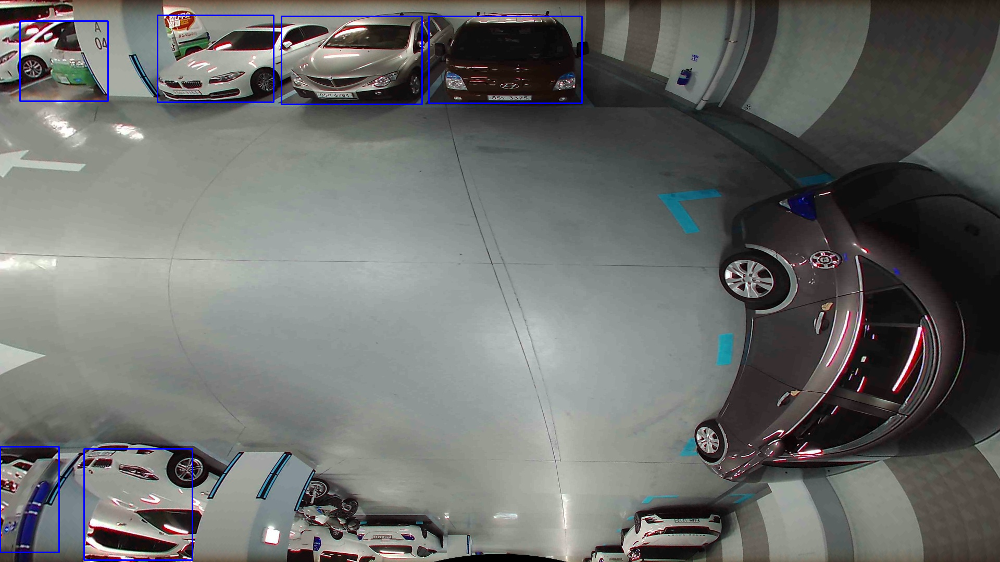

/home/jiun/conda/lib/python3.7/site-packages/ipykernel_launcher.py:116: RuntimeWarning: invalid value encountered in true_divide
/home/jiun/conda/lib/python3.7/site-packages/ipykernel_launcher.py:121: RuntimeWarning: invalid value encountered in true_divide
  0%|          | 1/1313 [00:00<17:06,  1.28it/s, mAP=0.967]

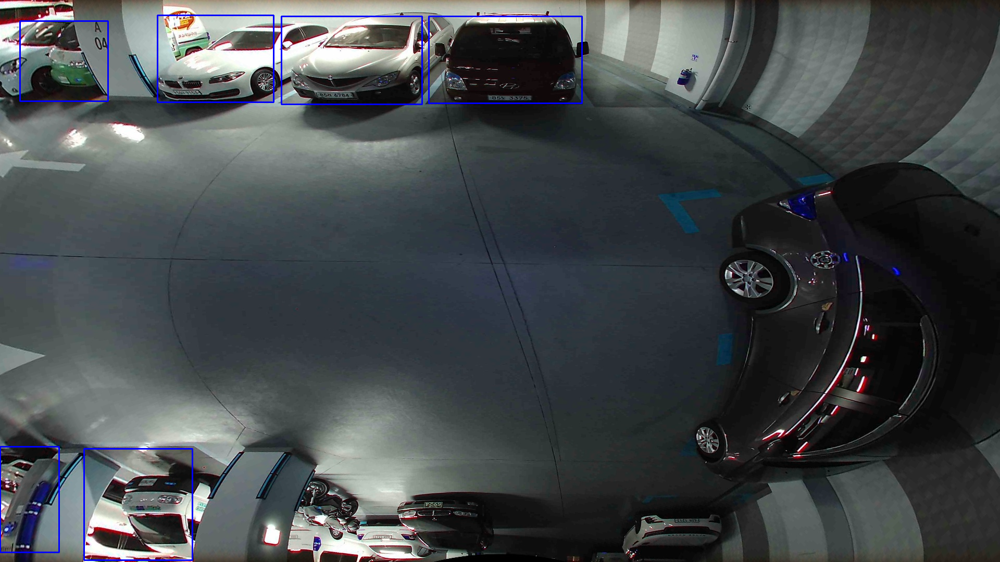

  0%|          | 2/1313 [00:01<17:52,  1.22it/s, mAP=0.968]

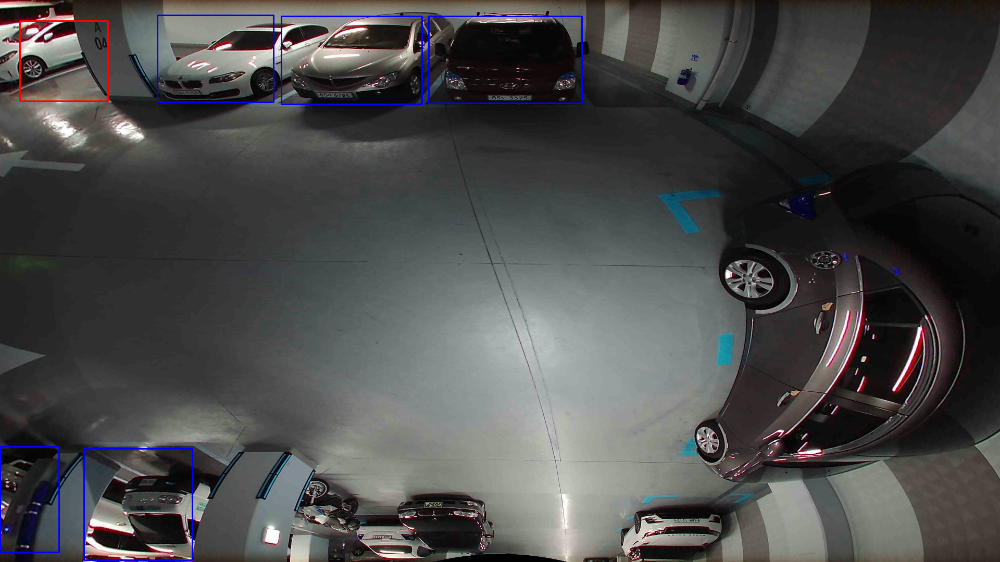

  0%|          | 3/1313 [00:02<17:30,  1.25it/s, mAP=0.97] 

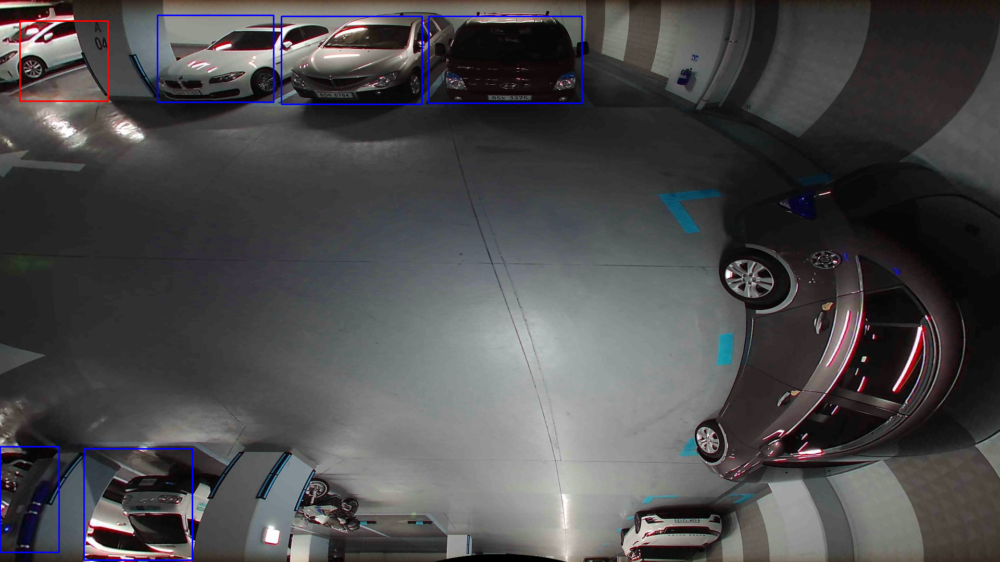

  0%|          | 4/1313 [00:03<17:22,  1.26it/s, mAP=0.972]

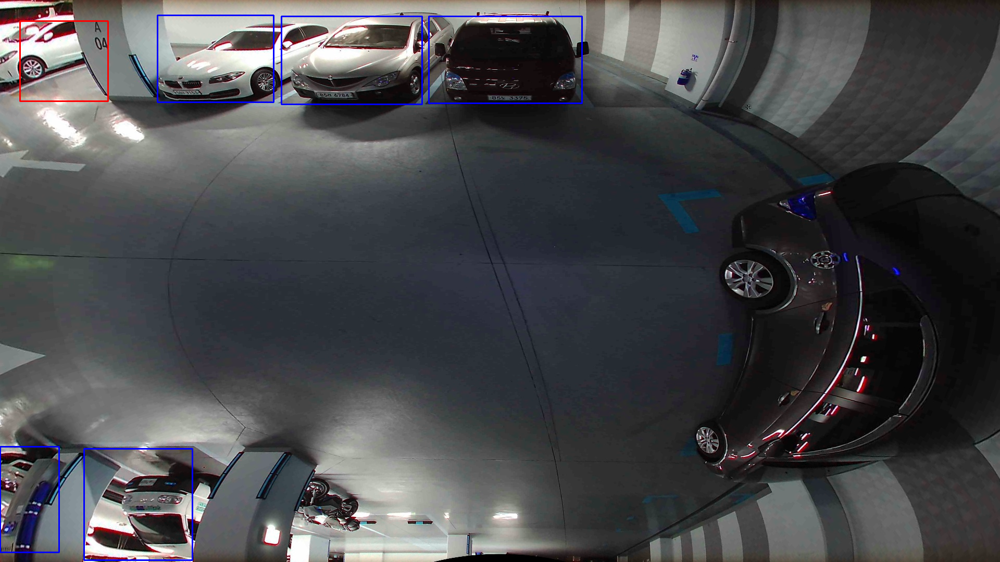

  0%|          | 5/1313 [00:04<18:10,  1.20it/s, mAP=0.973]

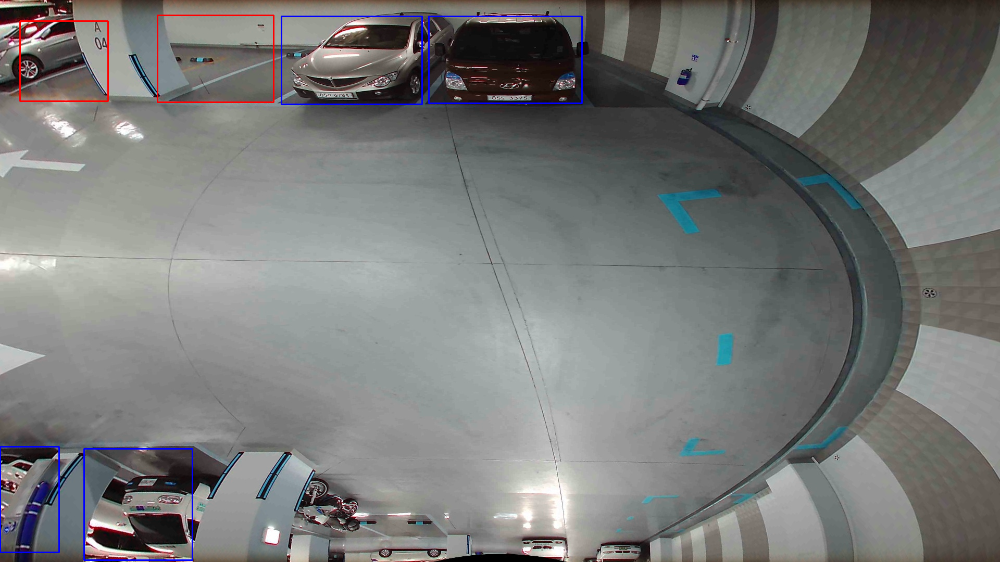

  0%|          | 6/1313 [00:04<18:13,  1.20it/s, mAP=0.974]

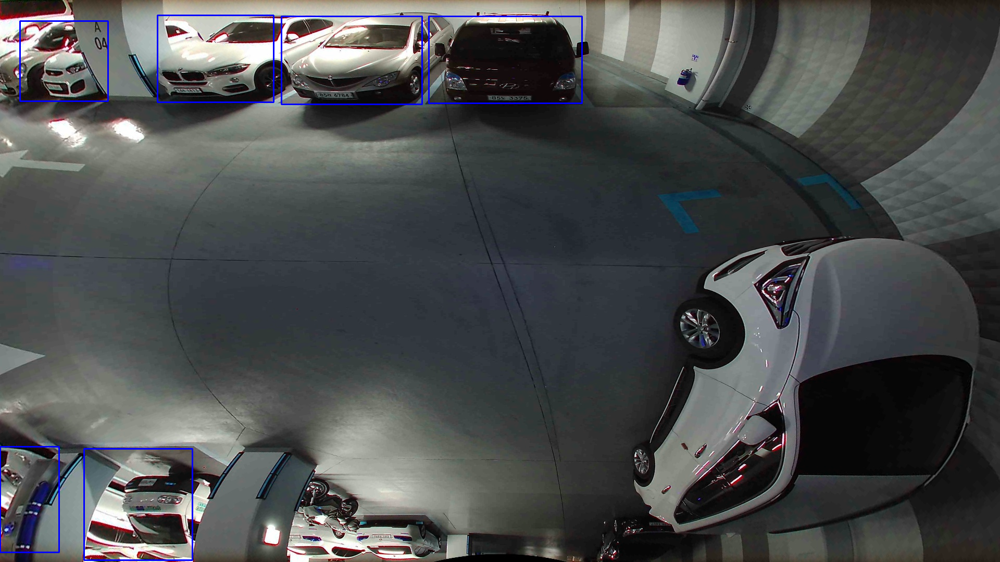

  1%|          | 7/1313 [00:05<18:31,  1.18it/s, mAP=0.975]

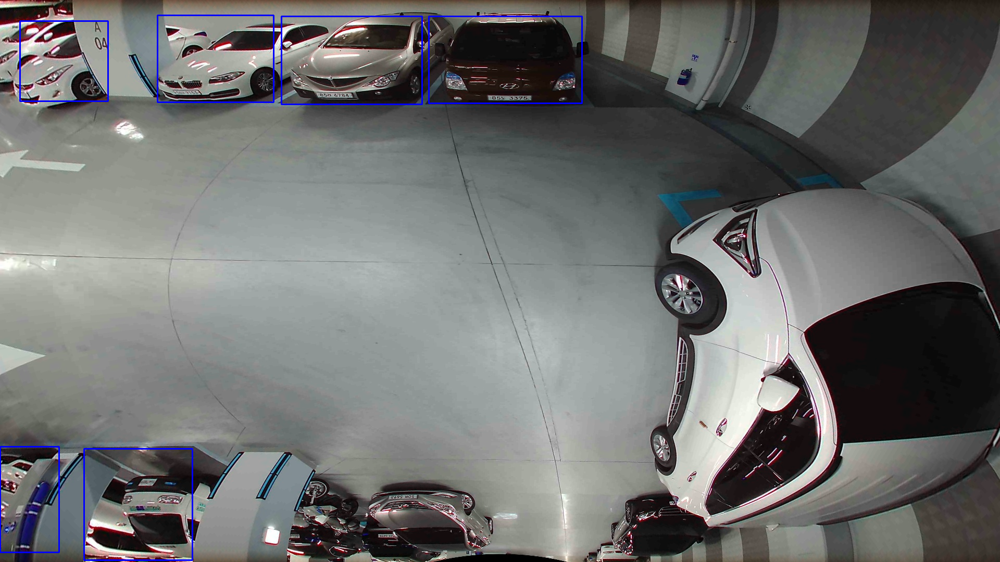

  1%|          | 8/1313 [00:06<18:17,  1.19it/s, mAP=0.976]

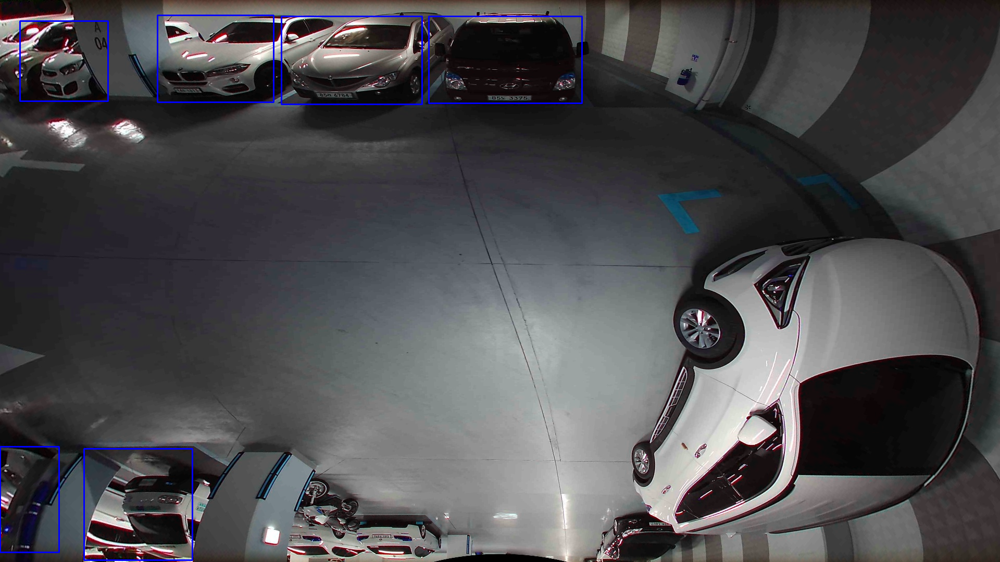

  1%|          | 9/1313 [00:07<17:42,  1.23it/s, mAP=0.976]

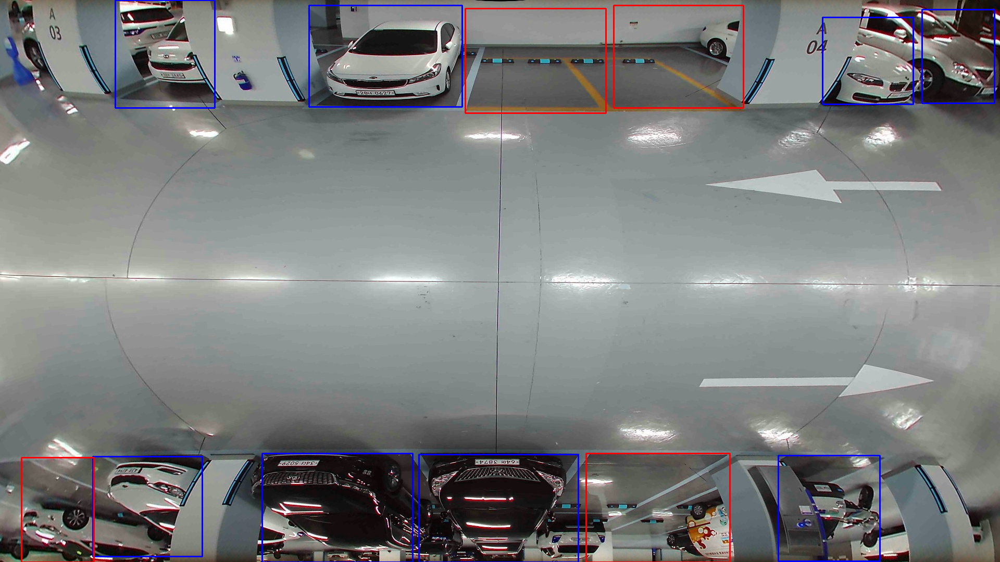

  1%|          | 10/1313 [00:08<19:29,  1.11it/s, mAP=0.975]


KeyboardInterrupt: 

In [94]:
with tqdm(total=len(images)) as tq:
    for image, gt, dt, pt in zip(images, annots, detections, parkings):
        flag, *_ = gt.stem.split('_CT_')

        try:
            g = pd.read_csv(str(gt), header=None).values
        except:
            g = np.empty((0, 6))

        try:
            d = pd.read_csv(str(dt), header=None).values
        except:
            d = np.empty((0, 6))
        d[:, 2:] *= scale

        try:
            pp = pd.read_csv(str(parking_src.joinpath(f'{flag}.txt')), header=None).values
            pp[:, 2] += pp[:, 0]
            pp[:, 3] += pp[:, 1]
            p = pd.read_csv(str(pt), header=None).values
            
#             idx = p[:, 0] > 0
#             pp = pp[idx]
#             p = p[idx]
        except:
            pp = np.empty((0, 4), dtype=np.int16)
            p = np.empty((0, 2), dtype=np.int16)

        assert len(pp) == len(p)
        p = np.hstack((p, pp))

        img = cv2.imread(str(image))

#         for *_, x, y, w, h in d:
#             cv2.rectangle(img, (int(x), int(y)), (int(w), int(h)), (0, 0, 255), 3)

        for klass, conf, x, y, w, h in p:
            cv2.rectangle(img, (int(x), int(y)), (int(w), int(h)), (0, 0, 255) if klass else (255, 0, 0), 2)

        scores = d[:, 1]
        boxes = d[:, 2:]
#         scores = np.concatenate((d[:, 1], p[:, 1]))
#         boxes = np.concatenate((d[:, 2:], p[:, 2:]))

        idx = scores.argsort()
        scores = scores[idx]
        boxes = boxes[idx].reshape(-1, 4)

        idx = nms(torch.from_numpy(boxes), torch.from_numpy(scores), .5)
        scores = scores[idx]
        boxes = boxes[idx].reshape(-1, 4)

#         for *_, x, y, w, h in boxes:
#             cv2.rectangle(img, (int(x), int(y)), (int(w), int(h)), (255, 0, 0), 1)

        evaluator.update((
            np.ones(np.size(boxes, 0), dtype=np.int),
            scores.astype(np.float32),
            boxes.astype(np.float32),
            None,
        ), (
            np.ones(np.size(g, 0), dtype=np.int),
            g.astype(np.float32),
            None,
        ))
        show(img)
        
        tq.set_postfix(mAP=evaluator.mAP.mean())
        tq.update(1)

In [63]:
evaluator.mAP # NMS .9 with parking

/home/jiun/conda/lib/python3.7/site-packages/ipykernel_launcher.py:116: RuntimeWarning: invalid value encountered in true_divide
/home/jiun/conda/lib/python3.7/site-packages/ipykernel_launcher.py:121: RuntimeWarning: invalid value encountered in true_divide


array([0.54702777, 0.54702777])

In [66]:
evaluator.mAP # NMS .5 with parking

/home/jiun/conda/lib/python3.7/site-packages/ipykernel_launcher.py:116: RuntimeWarning: invalid value encountered in true_divide
/home/jiun/conda/lib/python3.7/site-packages/ipykernel_launcher.py:121: RuntimeWarning: invalid value encountered in true_divide


array([0.87328393, 0.87328393])

In [60]:
evaluator.mAP # NMS .1 with parking

/home/jiun/conda/lib/python3.7/site-packages/ipykernel_launcher.py:116: RuntimeWarning: invalid value encountered in true_divide
/home/jiun/conda/lib/python3.7/site-packages/ipykernel_launcher.py:121: RuntimeWarning: invalid value encountered in true_divide


array([0.85566528, 0.85566528])

In [45]:
evaluator.mAP # No NMS

/home/jiun/conda/lib/python3.7/site-packages/ipykernel_launcher.py:116: RuntimeWarning: invalid value encountered in true_divide
/home/jiun/conda/lib/python3.7/site-packages/ipykernel_launcher.py:121: RuntimeWarning: invalid value encountered in true_divide


array([0.93409114, 0.93409114])

In [42]:
evaluator.mAP # NMS .9

/home/jiun/conda/lib/python3.7/site-packages/ipykernel_launcher.py:116: RuntimeWarning: invalid value encountered in true_divide
/home/jiun/conda/lib/python3.7/site-packages/ipykernel_launcher.py:121: RuntimeWarning: invalid value encountered in true_divide


array([0.93409114, 0.93409114])

In [78]:
evaluator.mAP # NMS .5

/home/jiun/conda/lib/python3.7/site-packages/ipykernel_launcher.py:116: RuntimeWarning: invalid value encountered in true_divide
/home/jiun/conda/lib/python3.7/site-packages/ipykernel_launcher.py:121: RuntimeWarning: invalid value encountered in true_divide


array([0.93409114, 0.93409114])

In [39]:
evaluator.mAP # NMS .1

/home/jiun/conda/lib/python3.7/site-packages/ipykernel_launcher.py:116: RuntimeWarning: invalid value encountered in true_divide
/home/jiun/conda/lib/python3.7/site-packages/ipykernel_launcher.py:121: RuntimeWarning: invalid value encountered in true_divide


array([0.84946344, 0.84946344])

In [80]:
evaluator = Evaluator(n_class=2)

In [81]:
last_mAP, last_index, last_value = 1., [], []

In [82]:
with tqdm(total=len(images)) as tq:
    for i, (image, gt, dt, pt) in enumerate(zip(images, annots, detections, parkings)):
        flag, *_ = gt.stem.split('_CT_')

        try:
            g = pd.read_csv(str(gt), header=None).values
        except:
            g = np.empty((0, 6))

        try:
            d = pd.read_csv(str(dt), header=None).values
        except:
            d = np.empty((0, 6))
        d[:, 2:] *= scale

        try:
            pp = pd.read_csv(str(parking_src.joinpath(f'{flag}.txt')), header=None).values
            pp[:, 2] += pp[:, 0]
            pp[:, 3] += pp[:, 1]
            p = pd.read_csv(str(pt), header=None).values
            
            idx = p[:, 0] > 0
            pp = pp[idx]
            p = p[idx]
        except:
            pp = np.empty((0, 4), dtype=np.int16)
            p = np.empty((0, 2), dtype=np.int16)

        assert len(pp) == len(p)
        p = np.hstack((p, pp))

        scores = d[:, 1]
        boxes = d[:, 2:]
#         scores = np.concatenate((d[:, 1], p[:, 1]))
#         boxes = np.concatenate((d[:, 2:], p[:, 2:]))

#         idx = scores.argsort()
#         scores = scores[idx]
#         boxes = boxes[idx].reshape(-1, 4)

#         idx = nms(torch.from_numpy(boxes), torch.from_numpy(scores), .5)
#         scores = scores[idx]
#         boxes = boxes[idx].reshape(-1, 4)

        evaluator.update((
            np.ones(np.size(boxes, 0), dtype=np.int),
            scores.astype(np.float32),
            boxes.astype(np.float32),
            None,
        ), (
            np.ones(np.size(g, 0), dtype=np.int),
            g.astype(np.float32),
            None,
        ))
        
        if last_mAP > evaluator.mAP.mean():
            last_index.append(i)
            last_value.append((last_mAP, evaluator.mAP.mean()))
        last_mAP = evaluator.mAP.mean()
        
        tq.set_postfix(mAP=evaluator.mAP.mean())
        tq.update(1)

  0%|          | 0/1313 [00:00<?, ?it/s]/home/jiun/conda/lib/python3.7/site-packages/ipykernel_launcher.py:116: RuntimeWarning: invalid value encountered in true_divide
/home/jiun/conda/lib/python3.7/site-packages/ipykernel_launcher.py:121: RuntimeWarning: invalid value encountered in true_divide
100%|██████████| 1313/1313 [00:18<00:00, 71.53it/s, mAP=0.941]


In [118]:
evaluator.dump()

/home/jiun/conda/lib/python3.7/site-packages/ipykernel_launcher.py:116: RuntimeWarning: invalid value encountered in true_divide
/home/jiun/conda/lib/python3.7/site-packages/ipykernel_launcher.py:121: RuntimeWarning: invalid value encountered in true_divide


(array([0.93409114, 0.93409114]),
 array([0.        , 0.98394912]),
 array([0.       , 0.9493287]))

In [58]:
images = np.load('../inputs.npy')
targets = np.load('../targets.npy')
outputs = np.load('../outputs.npy')

In [59]:
images = (np.transpose(images, (1, 2, 0)) / 1136 * 255).astype(np.uint8).copy()

In [60]:
targets[:, :4] *= 300

In [61]:
for x, y, w, h, *_ in targets:
    cv2.rectangle(images, (int(x), int(y)), (int(w), int(h)), (255, 0, 0), 3)

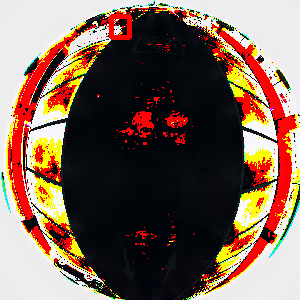

In [62]:
show(images)

In [38]:
for conf, x, y, w, h in outputs[0]:
    if conf > .0001:
        print(x,y,w,h)
        cv2.rectangle(images, (int(x), int(y)), (int(w), int(h)), (0, 255, 0), 1)

453.01895 455.87576 512.0 512.0
448.6123 0.0 512.0 37.33376
479.98102 0.0 512.0 18.577303
473.83884 490.31204 512.0 512.0
495.7051 0.0 512.0 25.759068


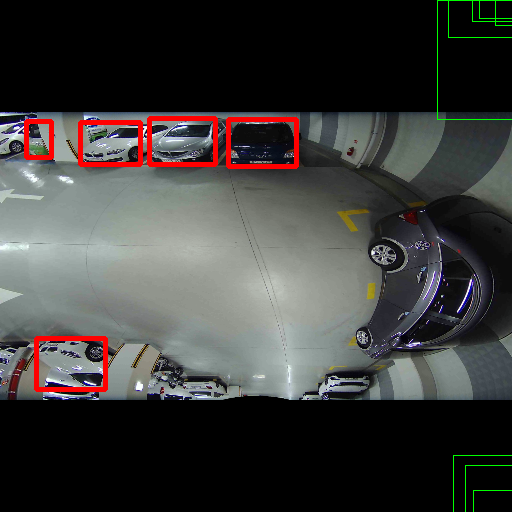

In [39]:
show(images)

In [85]:
scale = np.array((1920, 1080, 1920, 1080))

(1.0, 0.890909090909091)


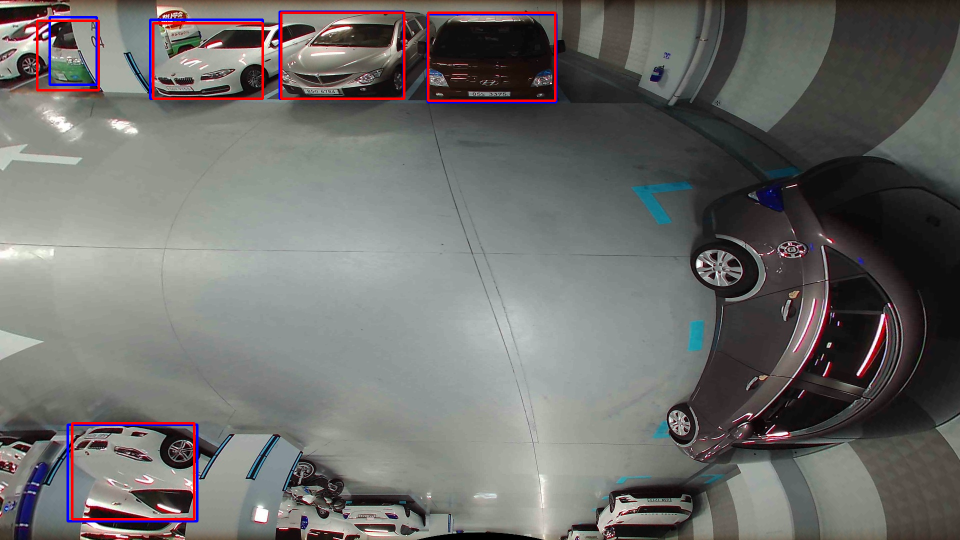

(0.9711971197119712, 0.9642178714660286)


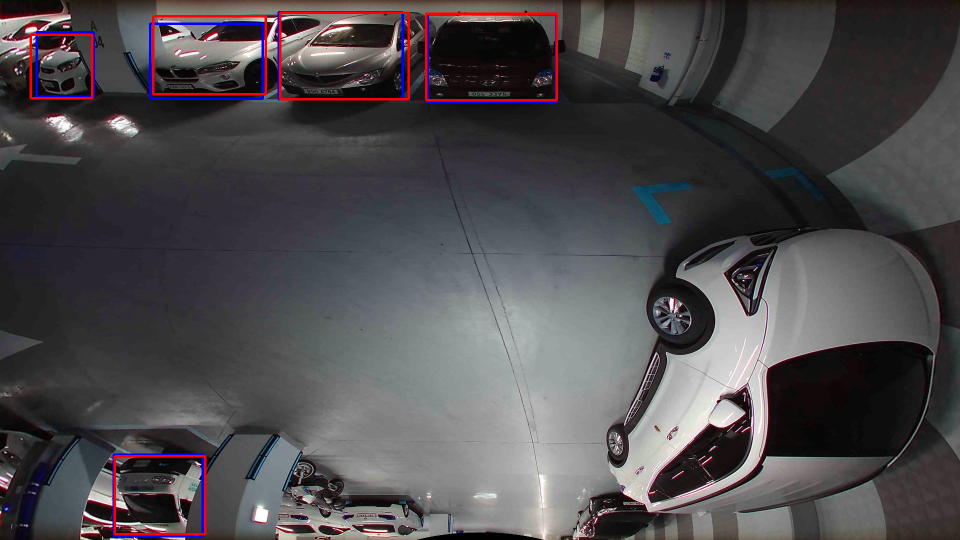

(0.9642178714660286, 0.9584907789496729)


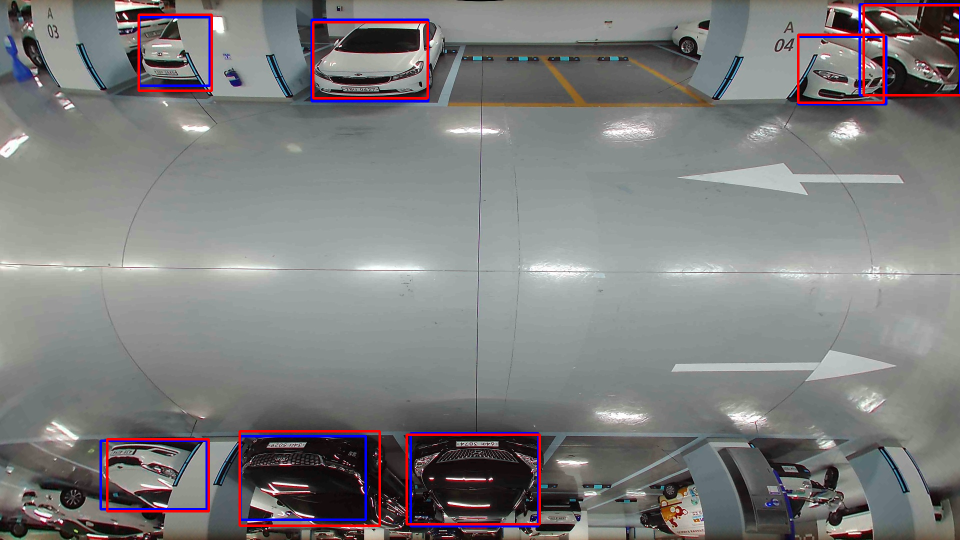

(0.9584907789496729, 0.9581931239107111)


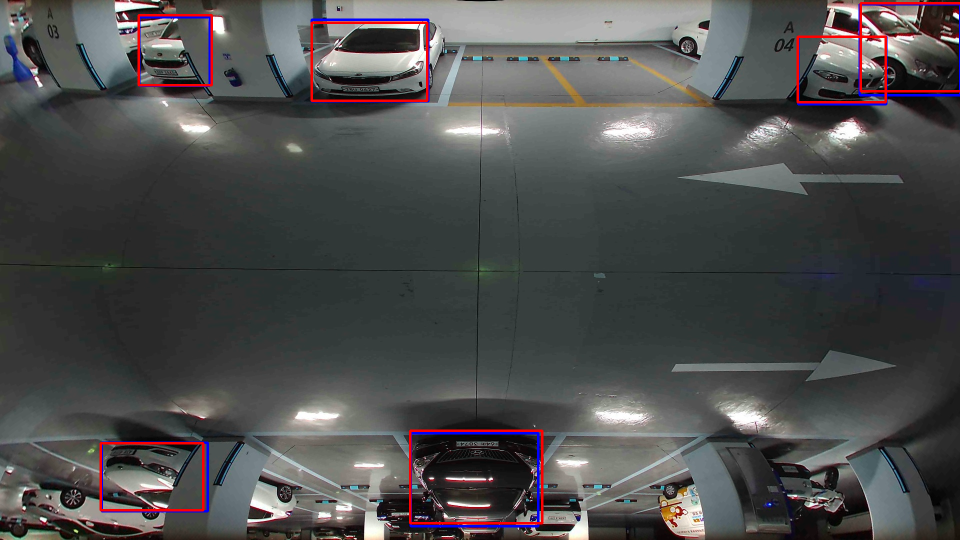

(0.9597045434428647, 0.9532460614585581)


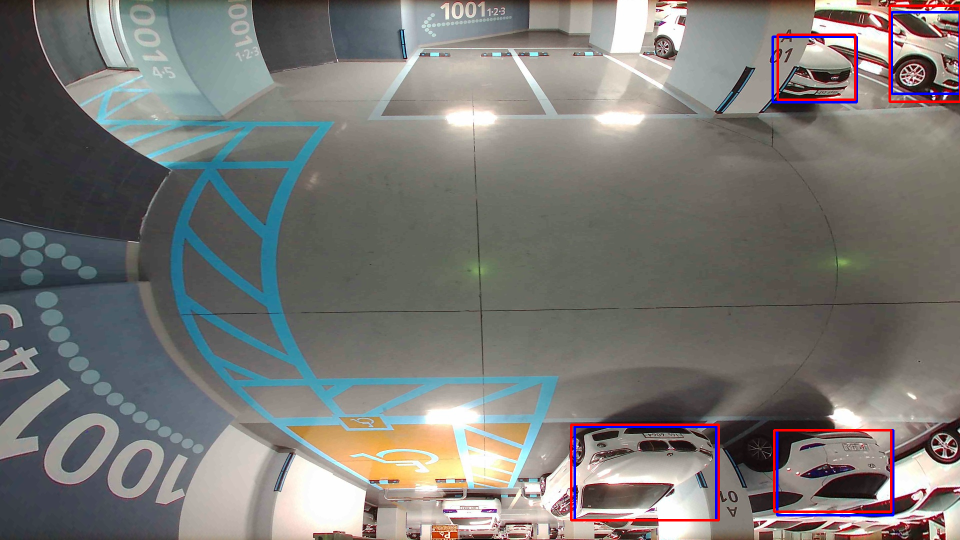

(0.9460284249280897, 0.9364327787399133)


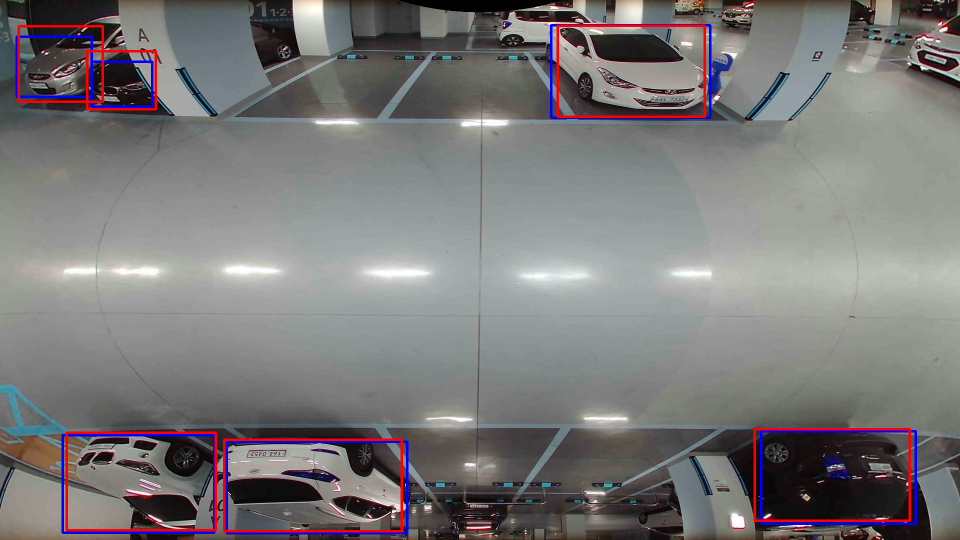

(0.9395479417338876, 0.9390521788004248)


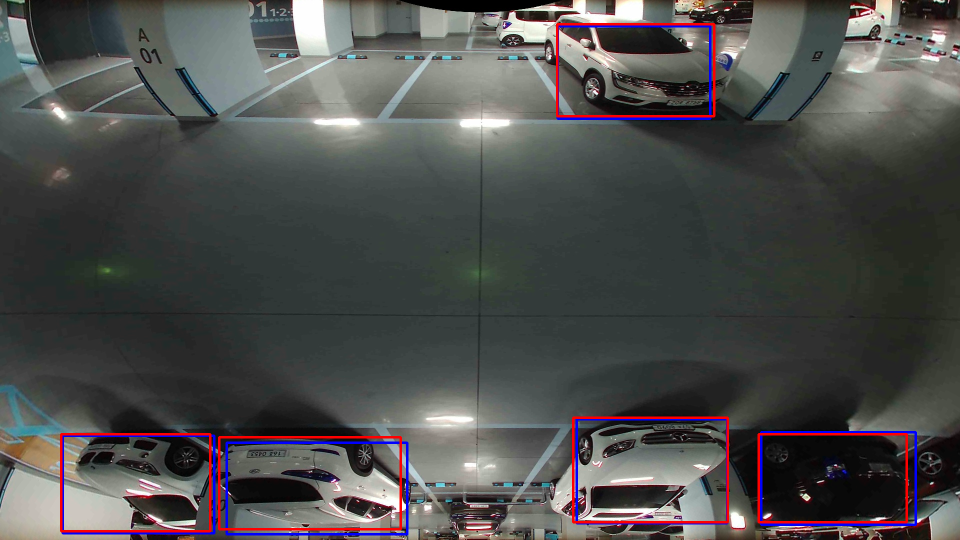

(0.9344362869909989, 0.9339700447077701)


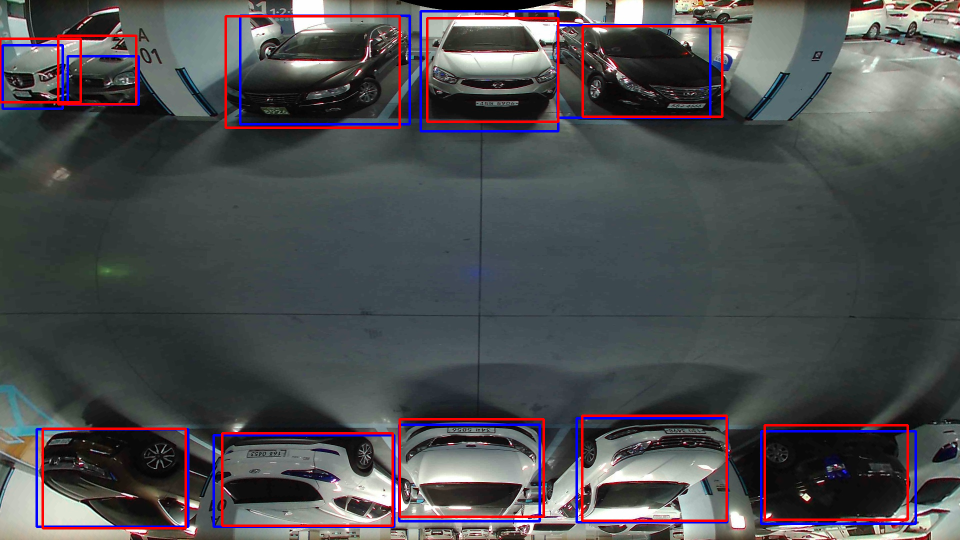

(0.9339700447077701, 0.930244518454881)


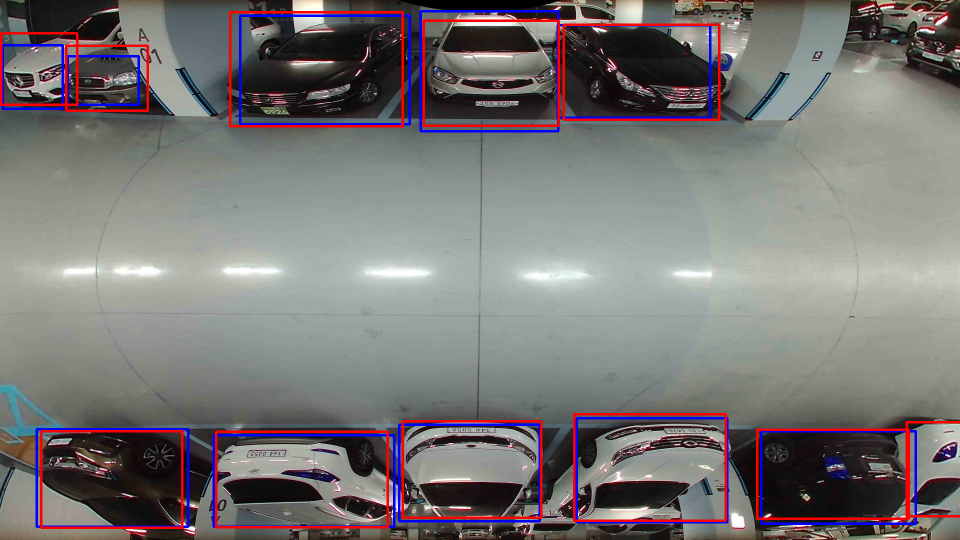

(0.9378311195742625, 0.9316924036223025)


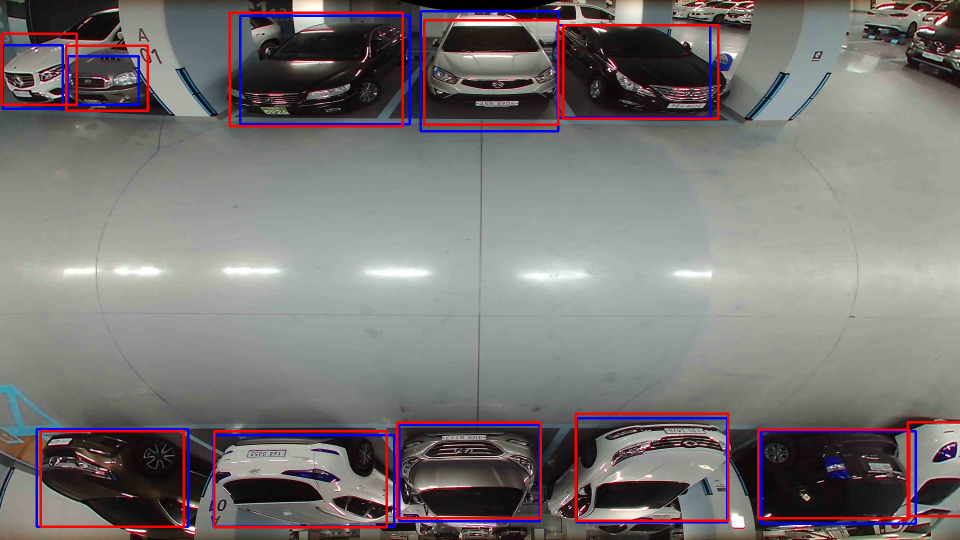

(0.9383399620633489, 0.9367052934339852)


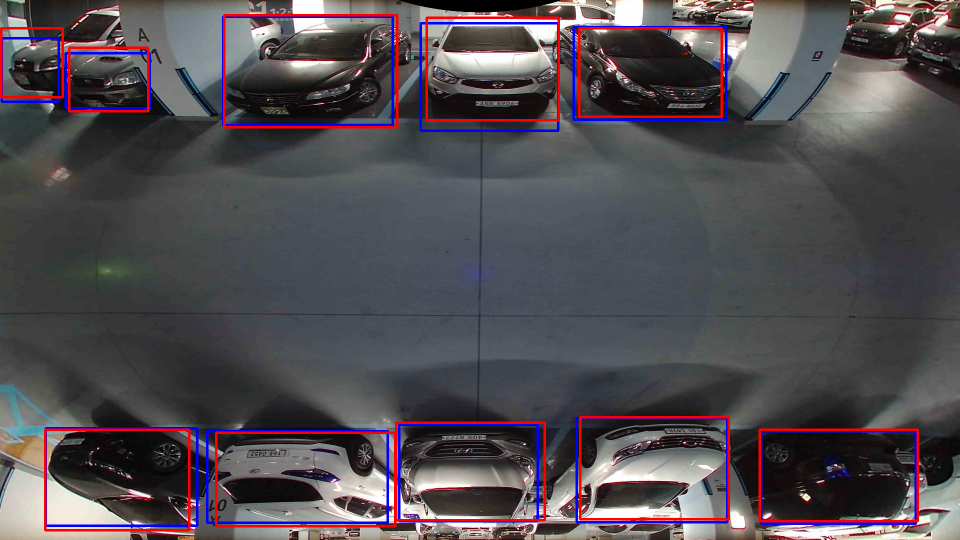

(0.9325503541593577, 0.931359105709081)


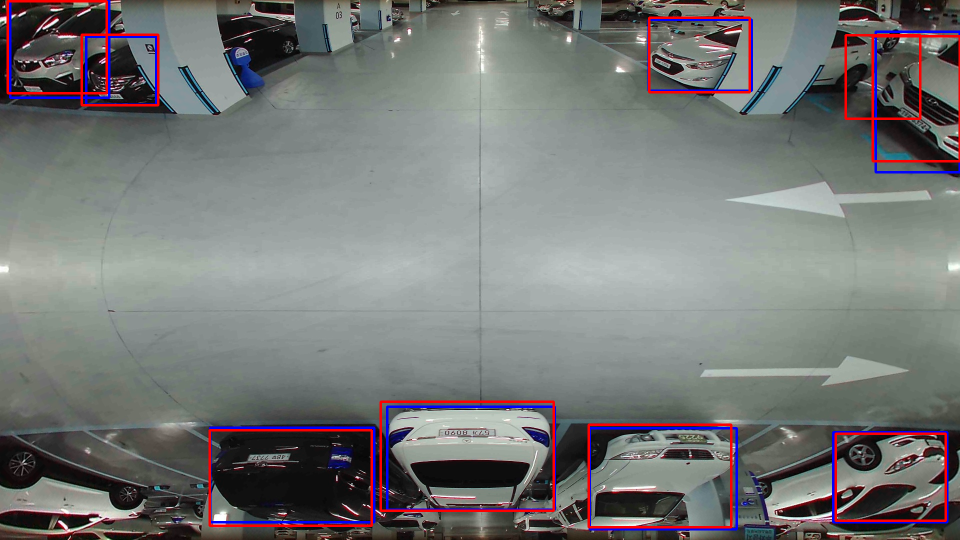

(0.931359105709081, 0.9291227890974791)


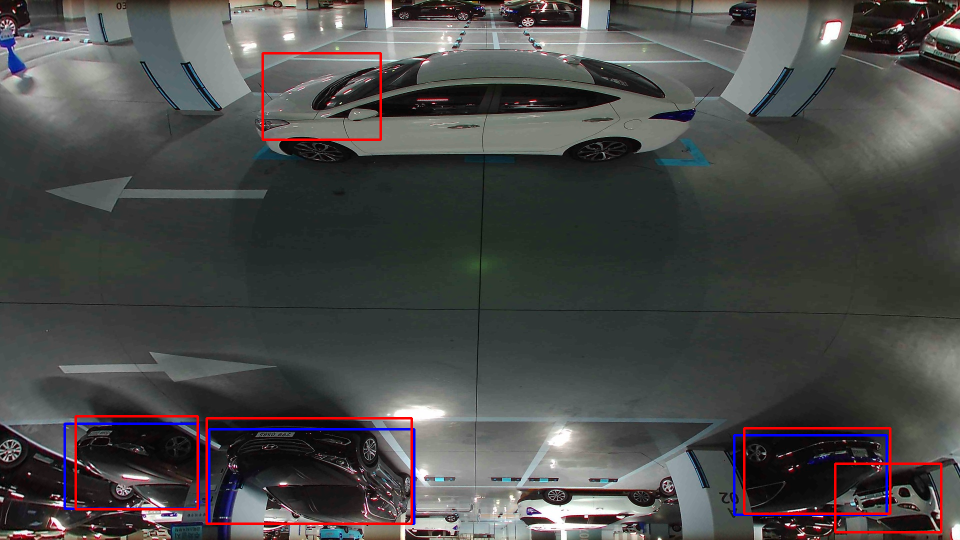

(0.929337622625646, 0.9286209017353789)


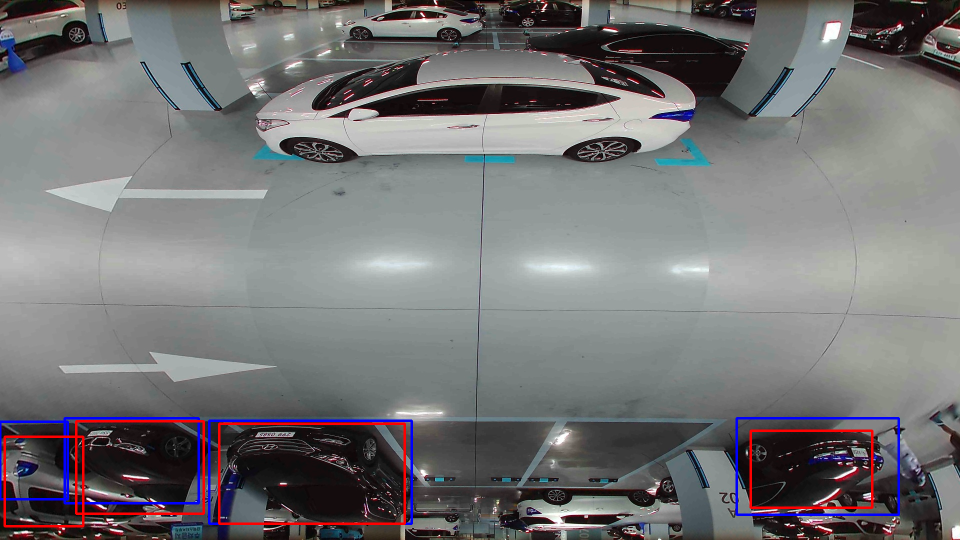

(0.932205778102559, 0.9303140556440632)


KeyboardInterrupt: 

In [86]:
for index in last_index:
    image = images[index]
    detection = detections[index]
    annot = annots[index]
    
    flag, *_ = gt.stem.split('_CT_')

    try:
        g = pd.read_csv(str(annot), header=None).values
    except:
        g = np.empty((0, 6))

    try:
        d = pd.read_csv(str(detection), header=None).values
    except:
        d = np.empty((0, 6))
        
    img = cv2.imread(str(image))
    
    
    for *_, x, y, w, h in g:
        cv2.rectangle(img, (int(x), int(y)), (int(w), int(h)), (0, 0, 255), 3)
    
    d[:, 2:] *= scale
    for *_, x, y, w, h in d:
        cv2.rectangle(img, (int(x), int(y)), (int(w), int(h)), (255, 0, 0), 3)
    
    print(last_value[index])
    show(cv2.resize(img, (0, 0), fx=.5, fy=.5))

In [67]:
from typing import Tuple, Union
from collections import defaultdict

import torch
import numpy as np


def compute_iou_(a, b):
    area = (b[:, 2] - b[:, 0]) * (b[:, 3] - b[:, 1])

    iw = torch.min(torch.unsqueeze(a[:, 2], dim=1), b[:, 2]) - torch.max(torch.unsqueeze(a[:, 0], 1), b[:, 0])
    ih = torch.min(torch.unsqueeze(a[:, 3], dim=1), b[:, 3]) - torch.max(torch.unsqueeze(a[:, 1], 1), b[:, 1])

    iw = torch.clamp(iw, min=0)
    ih = torch.clamp(ih, min=0)

    ua = torch.unsqueeze((a[:, 2] - a[:, 0]) * (a[:, 3] - a[:, 1]), dim=1) + area - iw * ih

    ua = torch.clamp(ua, min=1e-8)

    intersection = iw * ih

    IoU = intersection / ua

    return IoU


def compute_iou(box, boxes, box_area, boxes_area):
    y1 = np.maximum(box[0], boxes[:, 0])
    y2 = np.minimum(box[2], boxes[:, 2])
    x1 = np.maximum(box[1], boxes[:, 1])
    x2 = np.minimum(box[3], boxes[:, 3])
    intersection = np.maximum(x2 - x1, 0) * np.maximum(y2 - y1, 0)
    union = box_area + boxes_area[:] - intersection[:]
    iou = intersection / union
    return iou


def compute_overlaps(boxes1, boxes2):
    area1 = (boxes1[:, 2] - boxes1[:, 0]) * (boxes1[:, 3] - boxes1[:, 1])
    area2 = (boxes2[:, 2] - boxes2[:, 0]) * (boxes2[:, 3] - boxes2[:, 1])

    overlaps = np.zeros((boxes1.shape[0], boxes2.shape[0]))
    for i in range(overlaps.shape[1]):
        overlaps[:, i] = compute_iou(boxes2[i], boxes1, area2[i], area1)
    return overlaps


class Evaluator:
    def __init__(self, n_class: int, sample_patch: int = 11, threshold: float = .5):
        self.n_class = n_class
        self.patch = np.linspace(0, 1, sample_patch)
        self.threshold = threshold

        self.center_total = np.empty((0, 2), dtype=np.int)
        self.center_positive = np.empty((0, 2), dtype=np.int)

        self.TP, self.FP, self.FN = np.zeros((3, sample_patch, n_class), dtype=np.uint32)
        self.gt_counts, self.pd_counts = np.zeros((2, n_class), dtype=np.uint32)

    def update(self, predictions: Tuple[np.ndarray, Union[np.ndarray, None], np.ndarray, Union[np.ndarray, None]],
               groundtruths: Tuple[np.ndarray, np.ndarray, Union[np.ndarray, None]]) \
            -> None:
        """Update predictions and groundtruths for each frames.

        :param predictions: contains (class_ids, scores, bounding_boxes, masks)
        :param groundtruths: contains (class_ids, bounding_boxes, masks)
        :return:
        """
        pd_class_ids, pd_scores, pd_bboxes, pd_masks = predictions
        gt_class_ids, gt_bboxes, gt_masks = groundtruths

        if pd_scores is None:
            pd_scores = np.ones_like(pd_class_ids)

        if pd_bboxes.size > 0:
            iou = self.compute_iou(pd_bboxes, gt_bboxes, self.threshold)

        for klass in range(self.n_class):
            gt_number = np.sum(gt_class_ids == klass)

            self.gt_counts[klass] += gt_number
            self.pd_counts[klass] += (pd_class_ids == klass).sum()

            for p, patch in enumerate(self.patch):
                pd_mask = np.logical_and(pd_class_ids == klass, pd_scores >= patch)
                pd_number = np.sum(pd_mask)

                if pd_number == 0:
                    self.FN[p][klass] += gt_number
                    continue

                # X, Y distribution store
                centers = np.stack((pd_bboxes[:, ::2].mean(-1), pd_bboxes[:, 1::2].mean(-1))).T.astype(np.int)
                self.center_total = np.concatenate((self.center_total, centers))
                self.center_positive = np.concatenate((self.center_positive, centers[pd_mask]))

                true_positive = np.sum(iou[pd_mask][:, gt_class_ids == klass].any(axis=0))

                self.TP[p][klass] += true_positive
                self.FP[p][klass] += pd_number - true_positive
                self.FN[p][klass] += gt_number - true_positive

    @staticmethod
    def compute_iou(tar_boxes: np.ndarray, src_boxes: np.ndarray, threshold: float) \
            -> np.ndarray:
        iou = compute_overlaps(tar_boxes, src_boxes) >= threshold
        axis, argm = np.arange(np.size(iou, 0)), iou.argmax(axis=1)
        outputs = np.zeros_like(iou)
        outputs[axis, argm] = iou[axis, argm]
        return outputs >= threshold

    @property
    def precision(self) \
            -> np.ndarray:
        return np.nan_to_num(self.TP / (self.TP + self.FP)).mean(axis=0)

    @property
    def recall(self) \
            -> np.ndarray:
        return np.nan_to_num(self.TP / (self.TP + self.FN)).mean(axis=0)

    @property
    def mAP(self) \
            -> np.ndarray:
        prev_recall, ap = np.zeros((2, self.n_class))

        for precision, recall in zip(self.precision[::-1], self.recall[::-1]):
            ap += precision * (recall - prev_recall)
            prev_recall = recall

        return ap

    def dump(self) \
            -> Tuple[np.ndarray, np.ndarray, np.ndarray]:
        return self.mAP, self.precision, self.recall
